This lecture is about the overlap between gradient descent and Markov chain Monte Carlo. 
It consists of five sections, each of which is largely based on the following material:

 - [Gradient flows](https://francisbach.com/gradient-flows/) and [Rethinking SGD noise](https://francisbach.com/rethinking-sgd-noise/)
 - [Bayesian Learning via Stochastic Gradient Langevin Dynamics](https://www.stats.ox.ac.uk/~teh/research/compstats/WelTeh2011a.pdf)
 - [A Complete Recipe for Stochastic Gradient MCMC](https://arxiv.org/pdf/1506.04696.pdf)
 - [Bridging the Gap between SG-MCMC and Stochastic Optimization](https://arxiv.org/pdf/1512.07962.pdf)
 
This tutorial additionally refers to
 - [Stochastic quasi-Newton Langevin Monte Carlo paper](https://arxiv.org/pdf/1602.03442.pdf)
 - [A tutorial introduction to Monte Carlo methods, Markov chain Monte Carlo and particle filtering](https://www.cmpe.boun.edu.tr/~cemgil/Courses/cmpe548/cmpe58n-lecture-notes.pdf)
 - [MCMC using Hamiltonian dynamics](https://arxiv.org/pdf/1206.1901.pdf)
 - [MCMC demo](http://chi-feng.github.io/mcmc-demo/app.html?algorithm=HamiltonianMC&target=banana)
 - [hamiltorch library](https://github.com/AdamCobb/hamiltorch)
 
Each section contains an interactive demo or code snippet.
We will have short breaks after each section.
You are encouraged to play around with these during breaks.

Let's get started with importing the necessary libraries.
You need to install [hamiltorch](https://github.com/AdamCobb/hamiltorch) in addition to standard libraries.

In [1]:
%load_ext autoreload
%autoreload 2

import importlib, pickle, os, sys, copy, numpy as np

import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML
os.environ['KMP_DUPLICATE_LIB_OK']='True'
# %matplotlib notebook
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.serif": ["Palatino"],
})

import torch
import torch.nn as nn
import torch.nn.functional as F
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
import hamiltorch

from anim_utils import plot_opt_animation, plot_mcmc_animation, plot_mcmc_surface

## 1. Ordinary Differential Equations (ODEs) and Gradient Descent (GD)

### 1.1. Ordinary Differential Equations (ODEs) 
Ordinary differential equations involve an independent variable, its functions and derivatives of these functions. Formally, 

\begin{equation}
    \dot{x}(t) = \frac{dx(t)}{dt} = \lim_{\Delta t \rightarrow 0} \frac{ x(t + \Delta t) - x(t)}{\Delta t} = f(x(t),t),
\end{equation}

where 
- $t$ denotes time (or any other independent variable) 
- $x(t) \in \mathcal{X} \in \mathbb{R}^d$ is the state vector at time $t$ (thus dependent variable)
- $\dot{x}(t) \in \dot{\mathcal{X}} \in \mathbb{R}^d$ is the first order time derivative of $x(t)$
- $f : \mathcal{X} \times \mathbb{R}_+ \rightarrow \dot{\mathcal{X}}$ is the vector-valued and continuous (time) differential function describing the system's evolution over time with $\mathbb{R}_+$ denoting non-negative real numbers. 

We often refer to $f$ as *vector field* or *right hand side*.
Informally speaking, $f$ tells "how much the state $x(t)$ would change with an infinitisemal change in $t$". 


An "ODE state solution" $x(t)$ at time $t\in \mathbb{R}_+$ is given by
\begin{equation}
	x(t) = x_0 + \int_0^t f(x_\tau)~d\tau,
\end{equation}
where $x_0$ denotes the initial value and $\tau \in \mathbb{R}_+$ is an auxiliary time variable.
Given an initial value $x_0$ and a set of time points $\{t_0,t_1,\ldots,t_N\}$, we are often interested in state solutions $x_{0:N}\equiv\{x(t_0),x(t_1),\ldots,x(t_N)\}$

#### Numerical Integration
Above integral has a tractable form only for very trivial differential functions (recall the integration rules from high school). 
This is why we almost always resort to _numerical simulation_. 

More formally, we consider the rate of change of $x$ around $t$: 
\begin{equation}
    x(t+\delta) = x(t) +  \delta f(x(t)) + o(||\delta||).
\end{equation}

Assuming we can live with the smaller error term, we obtain the following recursive (and discrete) algorithm to compute state solutions:
\begin{equation}
    x(t+\delta) = x(t) +  \delta f(x(t)).
\end{equation}

### 1.2. Gradient Descent (GD)

Gradient descent (GD) is by far the most commonly used optimization technique in deep learning era.
Here, we restrict ourself to maximum a-posteriori estimation problems.
Let's first set up the notation:
- $\theta$ denotes a parameter vector 
- $p(\theta)$ is our prior belief on the parameters
- $p(x\mid\theta)$ denotes the likelihood
- $X \equiv \{ x_i \}_{i=1}^N$ is an iid dataset

Posterior distribution is proportional to
$$ p(\theta \mid X) \propto \prod_i p(x_i \mid \theta) p(\theta).$$

In practice, MAP estimation task translates to minimizing minus log posterior density:
$$ \min_\theta~~ g(\theta) \equiv -\log p(\theta \mid X) = -\log p(\theta) - \sum_i \log p(x_i \mid \theta)$$ 

Gradient descent (GD) aims to minimize a function by taking _small_ steps in the direction of steepest descent, which is given by the gradient vector.
More concretely, it iterates the following update equation:

\begin{equation}
    \theta_{n+1} = \theta_{n} - \delta \nabla g(\theta_{n}),
\end{equation}

where $n$ denotes the current step, $\theta_{n}$ is the current iterate, and $\delta>0$ is the learning rate.

#### From GD to ODEs
Assuming that each GD update step takes "$\delta$ time", i.e. $\theta_{n} \equiv \theta(\delta n)$, and defining $t \equiv \delta n$, we obtain the following:

\begin{equation}
    \theta(t+\delta) = \theta(t) - \delta \nabla g(\theta(t)).
\end{equation}

Comparing this with the last equation in "numerical integration" section, we conclude that

**GD is an ODE system in which vector field is given by the gradient of the optimized function.**


Below we contrast gradient descent and ODE flow.

In [34]:
# the loss function
m    = torch.tensor([0.0,0.0])
std  = torch.tensor([[1.0,0.81],[0.81,1.0]])
dist = torch.distributions.MultivariateNormal(m,std)

def forward_simulate(f, x0, ts):
    X  = [x0]
    ode_steps = len(ts)-1
    for i in range(ode_steps):
        h  = ts[i+1]-ts[i]
        t  = ts[i]
        x  = X[i]
        x_next = x + h*f(t,x)
        X.append(x_next)
    X = torch.stack(X) # T,N,d
    return X

def loss_fnc(x):
    return -dist.log_prob(x)

# GD and ODE flow simulations
def solve_systems(gd_lr=0.33, num_iter=30, num_euler=50):
    x0_  = torch.tensor([0.,5.]).to(torch.float32)
    xpar = torch.nn.Parameter(x0_.clone()) # 1,P

    # gradient descent solution
    opt = torch.optim.SGD([xpar],lr=gd_lr)
    gd_loss_trace = []
    for i in range(num_iter):
        gd_loss_trace.append(xpar.detach().clone())
        opt.zero_grad()
        loss = loss_fnc(xpar)
        loss.backward()
        opt.step()
    gd_loss_trace = torch.stack(gd_loss_trace).numpy()

    # ode solution
    dt = gd_lr / num_euler
    ts = torch.arange(num_euler*num_iter) * dt
    x0 = torch.nn.Parameter(x0_.clone())
    def odef(t,x):
        f    = -loss_fnc(x)
        grad = torch.autograd.grad(f,x)[0]
        return grad
    ode_loss_trace = forward_simulate(odef, x0, ts) # T,P
    ode_loss_trace = ode_loss_trace.detach().numpy()
    
    return gd_loss_trace,ode_loss_trace


gd_loss_trace, ode_loss_trace = solve_systems()

anim = plot_opt_animation(loss_fnc, gd_loss_trace, ode_loss_trace)
HTML(anim.to_jshtml())

## 2. Are Stochastic Gradient Descent (SGD) and Stochastic Differential Equations (SDEs) Likewise Related? 

So far, we have seen that ODEs and GD are one of a kind.
Here, we naturally question wheter SDEs and SGD are likewise related or not.
Before discussing this in detail, we describe stochastic gradient descent (SGD), which is nothing other than GD in which the likelihood is evaluated on a minibatch.

Say $\Omega_t \subset \{1,\ldots,N\}$ is a random data subsample at iteration $t$.
The optimization task at this iteration becomes

$$ \min_{\theta_t}~~ -\log p(\theta_t) - \frac{N}{|\Omega_t|} \sum_{n \in \Omega_t} \log p(x_n \mid \theta_t).$$ 

It simply implies the following parameter update equation:

$$ \theta_{t+1} = \theta_t + \frac{\epsilon_t}{2} \left( \nabla \log p(\theta_t) + \frac{N}{|\Omega_t|} \sum_{n \in \Omega_t} \nabla \log p(x_n \mid \theta_t)   \right), $$

where $\epsilon_t$ is the stepsize at iteration $t$ which satisfies

$$ \sum_{t=1}^\infty \epsilon_t = \infty \qquad\qquad \sum_{t=1}^\infty \epsilon_t^2 < \infty $$

ensuring that (i) the parameters will reach the high probability regions no matter how far away it was initialized to, and (ii) the parameters will converge to the mode instead of just bouncing around it.

### 2.1. A Naive Attempt

So okay, obviously above update equation heavily resembles gradient descent.
Can we then show SDEs and SGD are related?
Since we do know that SDEs involve a noise process, what if we simply add a white noise to the above equation?
In particular, let's consider the following update equation:

$$ \theta_{t+1} = \theta_t + \frac{\epsilon_t}{2} \left( \nabla \log p(\theta_t) + \frac{N}{|\Omega_t|} \sum_{n \in \Omega} \nabla \log p(x_n \mid \theta_t) \right) + \epsilon_t \xi_t, \qquad \xi_t \sim \mathcal{N}(\xi_t; 0, I). $$

Techically, this equation converges to standard GD in the limit $\epsilon_t \rightarrow 0$.
Informally speaking, this is because the variance of the noise term is proportional to $\epsilon_t^2$ whereas gradient update term scales with $\epsilon_t$.
You can read the end of the blog post (https://francisbach.com/gradient-flows/) for a more rigorous argumentation.


### 2.2. Second Attempt
Okay, obviously the noise variance depended terribly on stepsize.
What if we downscale the step size for the noise process?
How about the following:

$$ \theta_{t+1} = \theta_t + \frac{\epsilon_t}{2} \left( \nabla \log p(\theta_t) + \frac{N}{|\Omega_t|} \sum_{n \in \Omega} \nabla \log p(x_n \mid \theta_t) \right) + \sqrt{\epsilon_t} \xi_t, \qquad \xi_t \sim \mathcal{N}(\xi_t; 0,I). $$

Inspecting carefully, this looks very much like the Euler-Maruyama discretization of an SDE.
To simplify the analysis, let's consider a fixed step size $\epsilon_t \equiv \epsilon$ and re-write above equation:

$$ \theta_{t+1} = \theta_t - \frac{\epsilon}{2} \nabla \left( - \log p(\theta \mid X ; \Omega)\right) +  \xi_t, \qquad \xi_t \sim \mathcal{N}(\xi_t; 0, {\epsilon}I). $$

Above equation is nothing but a discretization of the Langevin equation

$$ d\theta = - \frac{1}{2} \nabla U(\theta)dt + dB(t), \qquad U(\theta) \equiv - \log p(\theta \mid X ; \Omega)$$

where $B(t)$ is the standard Brownian motion.
As covered previously, this SDE leads to the following solution:

$$ p(\theta) \propto \exp(- U(\theta)) = p(\theta \mid X ; \Omega) $$

So, our second attempt indeed brought us to an SDE with an invariant measure.
That means, simulating this process allows us to sample from the posterior distribution.
In literature, this method is called [Stochastic Gradient Langevin Dynamics (SGLD)](https://www.stats.ox.ac.uk/~teh/research/compstats/WelTeh2011a.pdf) discovered by Welling and Teh.

**Note:** The resulting continous-time process has a discontinuous drift term due to minibathces. 
This complicates the analysis, which we will examine in Section 4.

#### MH correction
One detail that we omitted is that the discretization of the continuous-time process naturally incurs error.
Importantly, the resulting sequence of samples $\{\theta_t \}_{t=1}^\infty$ would not follow the target distribution $\exp(- U(\theta))$.
This can be addressed by performing so-called _Metropolis-Hestings correction_, which requires computing the posterior density on the entire dataset.

Similar to the SGD regime, the authors propose to reduce the step size $\epsilon \rightarrow 0$ as $t \rightarrow \infty$.
Consequently the discretization error will diminish so that the MH rejection probability will approach 0 and we may simply ignore this step.

### 2.3. Simple Gaussian Experiment
Below is a code snippet that implements the above idea.
The optimization problem is based on [Stochastic Quasi-Newton Langevin Monte Carlo paper](https://arxiv.org/pdf/1602.03442.pdf).
Here is the generative process:

\begin{align}
    \theta &\sim \mathcal{N}(0,S) \\
    A_i &= a + \mathbb{U}[0,b], \quad \forall i \in [1,N] \\
    x_i &\sim \mathcal{N}(A_i^\top \theta, \sigma), \quad \forall i \in [1,N]
\end{align}

where $\mathbb{U}$ is the uniform distribution and we set

\begin{align}
    N &= 500 \\
    S &= I  \\
    a &= [1,1]^\top \\
    b &= 0.1 \\
    \sigma &= 0.1
\end{align}

We assume known $A_i$ and $x_i$, and infer $\theta$.
You can play around with it by changing, e.g., (the skewness of) the loss function, step size, minibatch size, turning  the algorithm into optimization, etc.


In [4]:
# dataset generation
N = 500  # num data points
d = 2    # data dim
sig = 0.1 # emission parameter
S = torch.eye(d) # d,d

A = torch.ones(N, d)/d + 0.1*torch.randn(N,d) # N,d
L = torch.linalg.cholesky(S) # d,d
theta = L @ torch.randn(d,1) # d,1
x     = A @ theta + np.sqrt(sig)*torch.randn(N,1)

Next, we optimize and visualize:

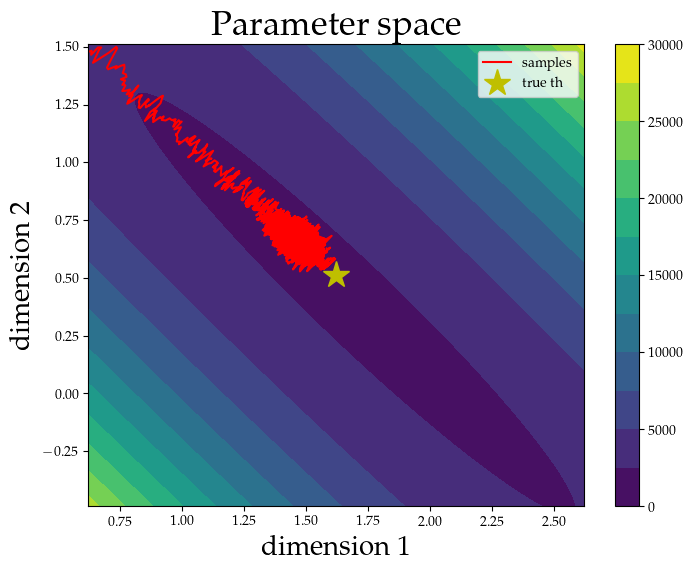

In [5]:
# optimization variables
NSTEPS = 15000
theta0 = torch.Tensor([[2.,4.]]).T # initial parameters

prior_dist = torch.distributions.Normal(torch.zeros(d),torch.ones(d)) 
th = torch.nn.Parameter(theta0) # initial parameters

# stochastic MAP computation
def map_estimate(th, frac=0.1):
    # get a minibatch 
    # th is [d,M]
    N_  = int(N*frac)
    idx = torch.randperm(N)[:N_]
    x_,A_ = x[idx],A[idx] # [N_,1], [N_,d]
    # MAP computation
    xhat  = A_ @ th # [N_,M]
    lhood = torch.distributions.Normal(xhat,sig).log_prob(x_) # [N_,M]
    lhood = lhood.sum(0) # [M]
    prior = prior_dist.log_prob(th.T) # [M,d]
    prior = prior.sum(1) # [M]
    return prior + 1/frac*lhood

# optimization loop
thetas,losses = [],[]
eta = 2.5e-5 # step size
for i in range(NSTEPS):
    thetas.append(th.detach().numpy().copy())
    MAP   = map_estimate(th, 0.1)
    grad  = torch.autograd.grad(MAP,th)[0]
    noise = torch.randn(d,1) * np.sqrt(eta)
    th.data = th.data + eta*grad/2 + noise
    losses.append(MAP.item())
thetas = np.array(thetas).squeeze(-1) # NSTEPS,d


###################################################
# visualizing the loss surface
Ngr = 100
w   = 1
xnp = np.linspace(theta[0]-w,theta[0]+w, Ngr)
ynp = np.linspace(theta[1]-w,theta[1]+w, Ngr)
X,Y = np.meshgrid(xnp, ynp)
XY  = torch.tensor(np.array([X.T.flatten(), Y.T.flatten()])).to(torch.float32)
map_XY = map_estimate(XY).reshape(Ngr,Ngr)
plt.figure(1,(8,6))
plt.contourf(X, Y, -map_XY, levels=10)
plt.colorbar()

# visualizing samples
plt.plot(thetas[:,0], thetas[:,1], color='r', label='samples')
plt.plot(theta[0,0].item(),theta[1,0].item(), 'y*', markersize=20, label='true th')
plt.xlim([theta[0]-w,theta[0]+w])
plt.ylim([theta[1]-w,theta[1]+w])
plt.title('Parameter space', fontsize=25)
plt.xlabel('dimension 1', fontsize=20)
plt.ylabel('dimension 2', fontsize=20)
plt.legend()

### 2.4. Completing the Picture with a Detour: SGD without Diffusion Process 

So far, we have discarded an important aspect of our stochastic optimization setup. 
That is, we utilize randomly sampled minibatches for optimization, which inherently brings stochasticity to the system.
[Rethinking SGD blog post](https://francisbach.com/rethinking-sgd-noise/) gives a very detailed analysis of SGD dynamics in over/under-parameterized NN regimes.
Here, we repeat the main finding.

Given a dataset $X \equiv \{ x_i \}_{i=1}^N$ and loss function $h(x;\theta)^2$, we define the "batch loss" by 
\begin{equation}
    R(\theta) \equiv  \frac{1}{N} \sum_i h(x_i;\theta)^2
\end{equation}

Note that this formulation could easily involve class labels as well, which we omit for ease in notation.
Given a minibatch $\Omega_n \subset \{1,\ldots,N\}$ at iteration $n$, SGD update equation is given by

\begin{align}
    \theta_{n+1} &= \theta_{n} - \delta \left( \sum_{i \in \Omega_n} \nabla h(x_i;\theta)^2\right).
\end{align}

Let's write this update equation using the batch gradient as follows:

\begin{align}
    \theta_{n+1} &= \theta_{n} - \delta  \nabla R(\theta_n) + \delta a_n(\theta_n), \qquad a_n(\theta_n) = \nabla R(\theta_n) - \sum_{i \in \Omega_n} \nabla h(x_i;\theta)^2.
\end{align}

Note that above update equation includes a deterministic term $\nabla R(\theta_n)$ as well as a stochastic update term $a_n(\theta_n)$.
It is shown that above SGD dynamics converges to the solution of the following SDE in the limit

\begin{equation}
    d\theta_t = b(\theta_t,t) + \sigma(\theta_t,t)dB(t)
\end{equation}

where 
 - $B(t)$ is the standard Brownian motion
 - Drift matches the gradient: $b(\theta_t,t) = - \nabla R(\theta_t)$
 - Diffusion matches the gradient noise: $\sigma(\theta_t,t) \sigma(\theta_t,t)^T = \delta \mathbb{E} [a_n(\theta_n) a_n(\theta_n)^T ] $

Again, please see the blog post for more details.

## 3. A Quick Recap of Markov Chain Monte Carlo

In Markov Chain Monte Carlo methods, we sample from a Markov chain with transition density (or kernel) $K(\theta_n \mid \theta_{n−1})$ so that the sampling process $\{ \theta_n \}_{n=1}^\infty$ would converge to a distribution of interest $\pi(\theta)$.
The transition rule is more explicitly given by

\begin{equation}
    p_n(\theta^\text{next}) ~=~ \int K(\theta^\text{next} \mid \theta) p_{n-1}(\theta) d\theta 
\end{equation}

Obviously, the process would not converge to $\pi(\theta)$ for all kernel choices.
In the following, we describe two elegant ways of designing a Markov chain for a given target distribution.

### 3.1. Metropolis-Hastings Algorithm

For continuous Markov processes, an extremely simple procedure was defined by Metropolis and later extended by Hastings. 
The algorithm simply generates a _candidate_ next state using a proposal density $q(\theta^\text{next} \mid \theta)$ that depends on the current sample $\theta$.
For instance, "random-walk" MH is defined as follows 

$$q(\theta^\text{next} \mid  \theta) \equiv \mathcal{N}( \theta^\text{next}; \theta, \sigma I).$$

The candidate is accepted with probability

\begin{equation}
    \alpha (\theta \rightarrow \theta^\text{next}) = \min \{ 1, \frac{q(\theta\mid \theta^\text{next}) \pi(\theta^\text{next})} {q(\theta^\text{next} \mid \theta)\pi(\theta)} \}
\end{equation}

If the sample is not accepted, the chain stays put at the old location $\theta$.
Below algorithm summarizes our description so far, taken kindly from [these lecture notes](https://www.cmpe.boun.edu.tr/~cemgil/Courses/cmpe548/cmpe58n-lecture-notes.pdf).

<img src="etc/mh.png" width="750"/>

#### 3.1.1. Ergodicity
Valid MCMC samplers would converge to a unique invariant distribution regardless of the initial states.
This only happens if the chain is _ergodic_, i.e., if it eventually visits the entire state space.
Ergodicity is specified by the following:
 - irreducibility, meaning that each state can be visited starting from each other (i.e. state transition diagram should be fully connected)
 - aperiodicity, meaning that each state can be visited at any time n larger than some fixed number.

Please see the [lecture notes](https://www.cmpe.boun.edu.tr/~cemgil/Courses/cmpe548/cmpe58n-lecture-notes.pdf) for more details.

#### 3.1.2. Detailed balance
The stationary distribution of the Markov chain should satisfy

\begin{equation}
    \pi(\theta^\text{next}) = \int K(\theta^\text{next} \mid \theta) \pi(\theta) d\theta.
\end{equation}

MH transitions satisfy a stronger condition known as _detailed balance_

\begin{equation}
    K(\theta \mid \theta^\text{next} ) \pi(\theta^\text{next}) = K(\theta^\text{next} \mid \theta) \pi(\theta).
\end{equation}

We can prove that MH kernel indeed targets the above stationary distribution by showing (i) detailed balance implies above stationary distribution, and (ii) MH acceptance ratio ensures the detailed balance condition.

We note that there are Markov processes with stationary distributions that do not have detailed balance.
Please, again, refer to the lecture notes for a derivation of the detailed balance condition.

#### 3.1.3. Random-walk MH Demo
Let's check this demo to see how "random-walk" MH proceeds: https://chi-feng.github.io/mcmc-demo/app.html?algorithm=RandomWalkMH&target=banana

### 3.2. Hamiltonian (Hybrid) Monte Carlo (HMC)

The main idea in HMC is to use Hamiltonian dynamics to produce distant proposals for the Metropolis-Hastings algorithm.
By using the physical properties of the underlying system, we hope to generate transitions that span the entire state space variance and therefore eliminate the diffusive behaviour of random-walk proposals.

#### 3.2.1. Hamiltonian dynamics
Hamiltonian dynamics is a dynamical system governed by Hamilton's equations, which is commonly used to describe physical systems such as a planetary system or an electron in an electromagnetic field. 
As a simple example, we consider a ball that slides on a surface of varying height. 
The state of this system consists of the position of the ball, given by a variable $\theta \in \mathbb{R}^2$, and the momentum of the ballis given $p \in \mathbb{R}^2$. 
The potential energy $U(\theta)$ of the ball is proportional to the height of the surface at its current position.
Its kinetic energy $K(p)=\frac{|p|^2}{2m}$, where $m$ is the mass of the ball.
On a flat surface, the puck moves at a constant velocity, equal to $\frac{p}{m}$.
If it encounters a rising slope, the ball’s momentum allows it to continue, with its kinetic energy decreasing and its potential energy increasing.

#### 3.2.2. Hamiltonian Monte Carlo
For Hamiltonian Monte Carlo, we usually use Hamiltonian functions written as follows:

\begin{align}
    H(\theta, p) = K(p) + U(\theta)
\end{align}

Here, $K(p): \mathbb{R}^d \mapsto \mathbb{R}$ is called the _kinetic energy_, and is usually defined as 

\begin{align}
    K(p) \equiv \frac{p^T M^{-1} p}{2} = -\log \mathcal{N}(p;0,M) + c,
\end{align}

where $M$ is a symmetric, positive-definite “mass matrix”, which is typically diagonal, and is often a scalar multiple of the identity matrix. 
This form for $K(p)$ corresponds to minus the log probability density (plus a constant) of the zero-mean Gaussian distribution with covariance matrix $M$.

$U(\theta): \mathbb{R}^d \mapsto \mathbb{R}$ is called the _potential energy_, and will be defined to be minus the log probability density of the distribution for $\theta$ that we wish to sample from:

\begin{align}
    U(\theta) \equiv -\log p(\theta \mid X).
\end{align}

The partial derivatives of the Hamiltonian determine how $\theta$ and $p$ change over time according to Hamilton’s equations:

\begin{align}
    \frac{d\theta_i}{dt} = \frac{\partial H}{\partial p_i} = [M^{-1}p]_i, \qquad  \frac{dp_i}{dt} = -\frac{\partial H}{\partial \theta_i} = \frac{\partial U}{\partial \theta_i}
\end{align}


#### 3.2.3. Practical Algorithm
- **Step-1:** 
New values for the momentum variables are randomly drawn from their Gaussian distribution

$$p \sim \mathcal{N}(p ; 0,M)$$

- **Step-2:** 
Hamiltonian dynamics are simulated for a MH proposal. 
For simulation, a reversible and volume-preserving numerical simulator (such as leap-frog method) is used.
A proposed state $[\theta^\text{new},p^\text{new}])$ is accepted based on the following probability:

$$ \min \{1, \exp(−H(\theta^\text{new},p^\text{new}) + H(\theta^\text{old},p^\text{old})\} \equiv \min \{1,\frac{p(\theta^\text{new} \mid X) \mathcal{N}(p^\text{new};0,M)} {p(\theta \mid X) \mathcal{N}(p;0,M) }\} $$

#### 3.2.4. Notes

**1.**
Hamiltonian dynamics are reversible, i.e., mapping from a state $[\theta(t),p(t)]$ to another $[\theta(t+s),p(t+s)]$ is one-to-one, and hence has an inverse.
This is important to satisfy the detailed balance condition defined above and thereby we show that HMC updates leave the desired distribution invariant.

**2.** By construction, Hamiltonian dynamics have zero divergence, implying volume preservation. 
Thanks to this, we do not need to account for any change in volume in the acceptance probability for Metropolis updates. 
If we proposed new states using some arbitrary, non-Hamiltonian, dynamics, we would need to compute the determinant of the Jacobian matrix for the mapping the dynamics defines, which might well be infeasible.

### 3.3. Sampling an MLP via HMC

This example is taken from [hamiltorch library](https://github.com/AdamCobb/hamiltorch).
In the following, we show how a simple MLP $f: \mathbb{R} \mapsto \mathbb{R}$ can be inferred using HMC.
Our demonstration follows a simple $1D$ regression example.
Below is the dataset:

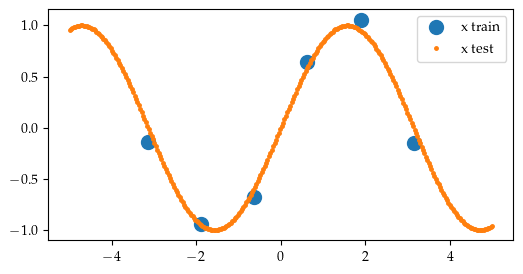

In [6]:
N_tr = 6
N_val = 300

x_val = torch.linspace(-5,5,N_val).view(-1,1)
y_val = torch.sin(x_val).view(-1,1)

x_train = torch.linspace(-3.14,3.14,N_tr).view(-1,1)
y_train = torch.sin(x_train).view(-1,1) + torch.randn_like(x_train)*0.1

plt.figure(figsize=(6,3))
plt.plot(x_train.numpy(),y_train.numpy(),'.',markersize=20, label='x train')
plt.plot(x_val.numpy(),y_val.numpy(),'.',markersize=5, label='x test')

plt.legend(fontsize=10)
plt.show()

x_train = x_train.to(device)
y_train = y_train.to(device)

x_val = x_val.to(device)
y_val = y_val.to(device)

Next, we implement our MLP:

In [7]:
class MLP(nn.Module):
    def __init__(self, nin=1, nout=1, H=50):
        super(MLP, self).__init__()
        self.layer1 = nn.Linear(nin, H)
        self.relu   = nn.ReLU()
        self.layer2 = nn.Linear(H, nout)

    def forward(self, x):
        x = self.layer1(x)
        x = self.relu(x)
        x = self.layer2(x)
        return x

Then we start sampling.

In [8]:
hamiltorch.set_random_seed(123)
mlp = MLP()
params_init = hamiltorch.util.flatten(mlp).to(device).clone()
step_size = 0.005
num_samples = 1000
num_steps_per_sample = 20
tau_out = 100.
params_hmc = hamiltorch.sample_model(mlp, x_train, y_train, model_loss='regression', params_init=params_init, \
                                     num_samples=num_samples, step_size=step_size, \
                                     num_steps_per_sample=num_steps_per_sample, tau_out=tau_out)

%time pred_list, log_prob_list = hamiltorch.predict_model(mlp, x=x_val, y=y_val, model_loss='regression', \
                                                          samples=params_hmc[:], tau_out=tau_out, \
                                                          tau_list=torch.ones(len(list(mlp.parameters()))))

print('\nExpected validation log probability: {:.2f}'.format(torch.stack(log_prob_list).mean()))
print('\nExpected MSE: {:.2f}'.format(((pred_list.mean(0) - y_val)**2).mean()))

Sampling (Sampler.HMC; Integrator.IMPLICIT)
Time spent  | Time remain.| Progress             | Samples   | Samples/sec
0d:00:00:13 | 0d:00:00:00 | #################### | 1000/1000 | 72.43       
Acceptance Rate 0.79
CPU times: user 257 ms, sys: 4.5 ms, total: 262 ms
Wall time: 267 ms

Expected validation log probability: -3207.61

Expected MSE: 0.09


Once we are done, we plot the sampled functions.
Note that the first half of the chain is considered as "burn-in" and hence discarded.

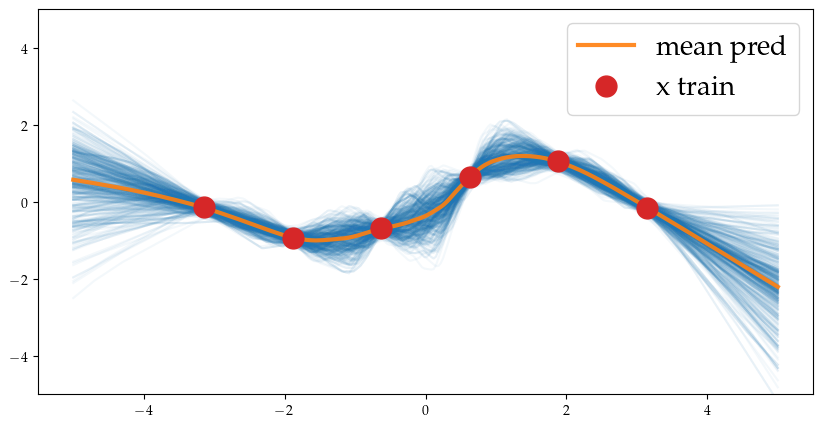

In [9]:
burn = num_samples//2
pred_list_ = pred_list[burn:]

plt.figure(figsize=(10,5))
plt.plot(x_val.cpu().numpy(), pred_list_.cpu().numpy().squeeze().T, 'C0', alpha=0.051)
plt.plot(x_val.cpu().numpy(),pred_list_.mean(0).cpu().numpy().squeeze().T, 'C1', alpha=0.9, \
         linewidth=3, label='mean pred')
# plt.fill_between(x_val.cpu().numpy().squeeze(), 
#                 pred_list_.mean(0).cpu().numpy().squeeze().T - 2*pred_list_.std(0).cpu().numpy().squeeze().T,
#                 pred_list_.mean(0).cpu().numpy().squeeze().T + 2*pred_list_.std(0).cpu().numpy().squeeze().T,
#                 alpha=.9, color='C1'
# )
plt.plot(x_train.cpu().numpy(),y_train.cpu().numpy(),'.C3',markersize=30, label='x train')


plt.legend(fontsize=20)
plt.ylim([-5,5])
plt.show()

#### Related Paper

If you would like to know more about Bayesian neural network posteriors via HMC, read [this great paper](https://arxiv.org/pdf/2104.14421.pdf). 
They note that producing a single sample with HMC on CIFAR datasets with ResNet-20-FRN architecture takes roughly one hour on their hardware.

<img src="etc/bnn-hmc.png" width="750"/>

<img src="etc/bnn-results-hmc.png" width="750"/>

### 3.4. Demo
Let's check this demo to see how HMC draws samples on the same "banana" distribution that we sampled from using random-walk MH: https://chi-feng.github.io/mcmc-demo/app.html?algorithm=HamiltonianMC&target=banana


## 4. A Complete Recipe for Stochastic Gradient MCMC

Naturally, any proposal distribution $q(x^\text{new} \mid x)$ implies a different MCMC algorithm.
How to choose a suitable MCMC algorithm and tune its hyper-parameters could be a tedious task.
Furthermore, the target distribution $\pi(x)$ is typically the posterior density, whose computation involves a computationaly demanding sum over data points in large data sets.
Consequently, we would like to build an MCMC method that can
 - be applied to any problem off-the-shelf
 - handle big data.

This is precisely what is done in the ["Complete Recipe paper"](https://arxiv.org/pdf/1506.04696.pdf).
There, the goal is to translate the task of sampling from the posterior distribution to simulating from a continuous dynamical system.
This dynamical system defines a Markov transition kernel.
More concretely, a differential equation is used to map the state $z(t)$ at time t to a "next" state $z(t+h)$.
One can then discuss the evolution of the distribution $p(z, t)$ given the dynamics (whether it converges or not, how fast it converges, etc).
The invariant distribution of the dynamics can be analyzed by the Fokker-Planck equation for stochastic dynamics and we use the Liouville equation for deterministic dynamics.

### 4.1. Formal Framework

Now we turn to SDEs similar to previous section, this time more rigorous.
Let's consider the following SDE

\begin{equation}
    dz = f(z)dt + \sqrt{2D(z)}dW(t)
\end{equation}

where
- $f(z): \mathbb{R}^d \mapsto \mathbb{R}^d$ denotes the deterministic drift.
- $D(z)$ is a positive semidefinite diffusion matrix.
- $W(t)$ is a $d$-dimensional Wiener process.
- $z$ could be the parameter of interest $z=\theta$ as in SGLD, or it could be an augmented variable $z=(\theta,p)$ as in HMC.
- similarly, Hamiltonian is either $H(z) = U(\theta)$ or  $H(\theta, p) = K(p) + U(\theta)$.
- we wish to sample from $p(\theta) \propto \exp(- U(\theta))$.

For this, we write $f(z)$ in terms of the target distribution:

\begin{equation}
    f(z) = -[D(z) + Q(z)] \nabla H(z) + \Gamma(z), \qquad \Gamma_i(z) = \sum_{j=1}^d \frac{\partial}{\partial z_j} (D_{ij}(z) + Q_{ij}(z))
\end{equation}
where $Q(z)$ is a skew-symmetric matrix, i.e., $Q^\top = -Q$.


#### Notes

**1.**
This holds for all positive semi-definite $D(z)$ and any skew-symmetric $Q(z)$. Specific choices of these matrices determine convergence speed.

**2.** 
The authors later show (in Theorem 2) that for any continuous Markov process with the desired stationary distribution $p(\theta) \propto \exp(- U(\theta))$, there exists an SDE as defined above.


### 4.2. How about Stochastic Gradients?
Discretizing above SDE with a step size $\epsilon_t$ gives

\begin{equation}
    z_{t+1} = z_t - \epsilon_t [(D(z_t) + Q(z_t)) \nabla H(z_t) + \Gamma(z_t)] + \mathcal{N}(0, 2\epsilon_t D(z_t)).
\end{equation}

Similar to section 2.4, let's write the stochastic gradient $\nabla \tilde{H}(z_t)$ in terms of a deterministic batch gradient and stochastic noise term:

\begin{equation}
    \nabla \tilde{H}(z_t) = \nabla H(z_t) + \mathcal{N}(0, V(z_t))
\end{equation}

Plugging this to the above SDE discretization, we obtain

\begin{equation}
    z_{t+1} ~~=~~ z_t ~-~ \epsilon_t \underbrace{[(D(z_t) + Q(z_t)) \nabla \tilde{H}(z_t) + \Gamma(z_t)]}_{\text{drift computed on a minibatch}} ~+~ \epsilon_t \underbrace{[D(z_t) + Q(z_t)]\mathcal{N}(0, V(z_t))}_{\text{noise due to stochastic gradient}} ~+~ \underbrace{\mathcal{N}(0, 2\epsilon_t D(z_t))}_{\text{diffusion}}.
\end{equation}

Assuming we have an estimate of the variance of the noise

$$ B_t \approx [D(z_t) + Q(z_t)]^2 V(z_t), $$

and simulate the following equation to account for the noise term:

\begin{equation}
    z_{t+1} = z_t - \epsilon_t [(D(z_t) + Q(z_t)) \nabla \tilde{H}(z_t) + \Gamma(z_t)] + \mathcal{N}(0, \epsilon_t (2D(z_t)-\epsilon_t B_t)).
\end{equation}

Obviously, in the limit of infinitesimally small step sizes $\epsilon_t$, the new variance will approach the old one: $\mathcal{N}(0, \epsilon_t (2D(z_t)-\epsilon_t B_t)) \rightarrow \mathcal{N}(0, 2\epsilon_t D(z_t))$ as $\epsilon_t \rightarrow 0$.
Thus, we would still target the correct invariant distribution.
With this, we would also avoid the MH correction step.

### 4.3. Some Instances of This Formulation

#### 4.3.1. Stochastic Gradient Langevin Dynamics
If we define 

\begin{align}
    H(z) &= - \log p(z \mid X ; \Omega) \\
    D(z) &= I \\
    Q(z) &= 0 \\
    B_t &= 0
\end{align}

then we obtain the SGLD update equation:

\begin{align}
    z_{t+1} = z_t + \epsilon_t \nabla \log p(z \mid X ; \Omega) + \mathcal{N}(0,2\epsilon_tI)
\end{align}

As can be noticed, the developed theory further improves SGLD by introducing a mechanism to handle the minibathcing noise.


#### 4.3.2. Hamiltonian Monte Carlo
If we define 

\begin{align}
    z    &= (\theta,p) \\
    H(z) &= \log p(\theta \mid X) + \frac{p^T M^{-1} p}{2} \\
    D(\theta,p) &= 0 \\
    Q(\theta,p) &= \begin{bmatrix} 0,-I \\ I,0 \end{bmatrix},
\end{align}

then we obtain the HMC update equation:

\begin{align}
    \begin{bmatrix} \theta_{t+1} \\ p_{t+1} \end{bmatrix} 
    = 
    \begin{bmatrix} \theta_{t} \\ p_{t} \end{bmatrix}
    + \epsilon_t \begin{bmatrix} -\partial H / \partial p \\ \partial H / \partial \theta \end{bmatrix} 
\end{align}

#### 4.3.3. Riemannian Manifold Hamiltonian Monte Carlo (RMHMC)
How can we further improve these methods?
A natural idea is to use the geometric information while traversing the state space.
For this, [Girolami et al](https://statmodeling.stat.columbia.edu/wp-content/uploads/2010/04/RMHMC_MG_BC_SC_REV_08_04_10.pdf) suggest adjusting LD and HMC to include Riemann manifold. <!-- This is based on the observation the natural geometric structure of the posterior space we aim to traverse is defined by the Riemannian manifold. --> In particular, they exploit Fisher information matrix (FIM), which defines the local curvature in distribution space for which KL-divergence is the metric.
Denoting the FIM matrix by $G(\theta)$, the following defines the RMHMC:

\begin{align}
    z    &= (\theta,p) \\
    H(z) &= \log p(\theta \mid X) + \frac{p^\top p}{2} \\
    D(\theta,p) &= \begin{bmatrix} 0,0 \\ 0,G(\theta)^{-1} \end{bmatrix} \\
    Q(\theta,p) &= \begin{bmatrix} 0,-G(\theta)^{-1/2} \\ G(\theta)^{-1/2},0 \end{bmatrix}.
\end{align}

This almost recovers the update equations in Girolami et al, defined as follows:

\begin{align}
    \theta_{t+1} &= \theta_{t} + \epsilon_t G(\theta)^{-1/2}p_t \\
    p_{t+1} &= p_{t} - \epsilon_t G(\theta)^{-1/2} \nabla \tilde{U}(\theta_t) - \epsilon_t G(\theta)^{-1/2}p_t + \mathcal{N}(0, \epsilon_t (2G(\theta_t)^{-1}-\epsilon_t B_t))
\end{align}


It is shown in the complete recipe paper that above chain cannot be expressed within the proposed framework.
In particular, we need to include an additional correction term $\nabla_\theta G(\theta)^{-1/2}$.
Complete recipe paper shows that including this term (gSGRHMC) leads to much better convergence to the posterior compared to not including it (naive gSGRHMC) as done by Girolami et al:

<img src="etc/sghmc2.png" width="750"/>

### 4.4. RMHMC Illustration
This example is taken from [hamiltorch library](https://github.com/AdamCobb/hamiltorch).
Here, to demonstrate the merits of RMHCM, we attempt to sample from a complicated distribution called [funnel distribution](https://projecteuclid.org/journals/annals-of-statistics/volume-31/issue-3/Slice-sampling/10.1214/aos/1056562461.full).
This distribution was introduced by Radford Neal to demonstrate the deficiencies of MCMC methods.
Let's use the vector $\mathbf{w} \equiv [v,x_1,\ldots,x_D]$ to denote this $D+1$ dimensional random variable with following pdf:

$$ p(\mathbf{w}) ~ \propto ~ \mathcal{N}(v;0,9) ~ \prod_{d=1}^D \mathcal{N}(x_i;0,\exp(-v)) $$

That is, we first draw a random variable $v$ that is independent of all other variables.
Then, conditioned on the value of $v$, we draw remaining variables.
We kindly take the below figure from [this tutorial](https://crackedbassoon.com/writing/funneling#Neal2003a), which illustrates random samples (left) and log likelihood (right) of two parameters from Neal’s funnel, $x_0$ and $v$:

<img src="etc/neals-funnel.svg" width="750"/>

Next, we define our target distribution:

In [8]:
D = 15

def funnel_ll(w, dim=D):
    v_dist = torch.distributions.Normal(0,3)
    ll = v_dist.log_prob(w[0])
    x_dist = torch.distributions.Normal(0, torch.exp(-w[0])**0.5)
    ll += x_dist.log_prob(w[1:]).sum()
    return ll

Then we sample using HMC:

In [ ]:
hamiltorch.set_random_seed(123)
params_init = torch.ones(D + 1)
params_init[0] = 0.
step_size = 0.2
num_samples = 1000 # For results in plot num_samples = 10000
L = 25

params_hmc = hamiltorch.sample(log_prob_func=funnel_ll, params_init=params_init, num_samples=num_samples,
                               step_size=step_size, num_steps_per_sample=L)

coords_hmc = torch.cat(params_hmc).reshape(len(params_hmc),-1).numpy()

... and RMHMC:

In [ ]:
# Explicit RMHMC with SOFTABS
hamiltorch.set_random_seed(123)
params_init = torch.ones(D + 1)
params_init[0] = 0.
step_size = 0.14 
num_samples = 1000
L = 25
omega=10
softabs_const=10**6
jitter=0.001

params_e_rmhmc = hamiltorch.sample(log_prob_func=funnel_ll, params_init=params_init, num_samples=num_samples,
                                   sampler=hamiltorch.Sampler.RMHMC, integrator=hamiltorch.Integrator.EXPLICIT,
                                   metric=hamiltorch.Metric.SOFTABS, jitter=jitter,
                                   num_steps_per_sample=L, step_size=step_size, explicit_binding_const=omega, 
                                   softabs_const=softabs_const)


coords_e_rmhmc = torch.cat(params_e_rmhmc).reshape(len(params_e_rmhmc),-1).numpy()

Above cells takes $>30$ mins to execute.
Therefore, we simply load the already collected samples and visualize them:

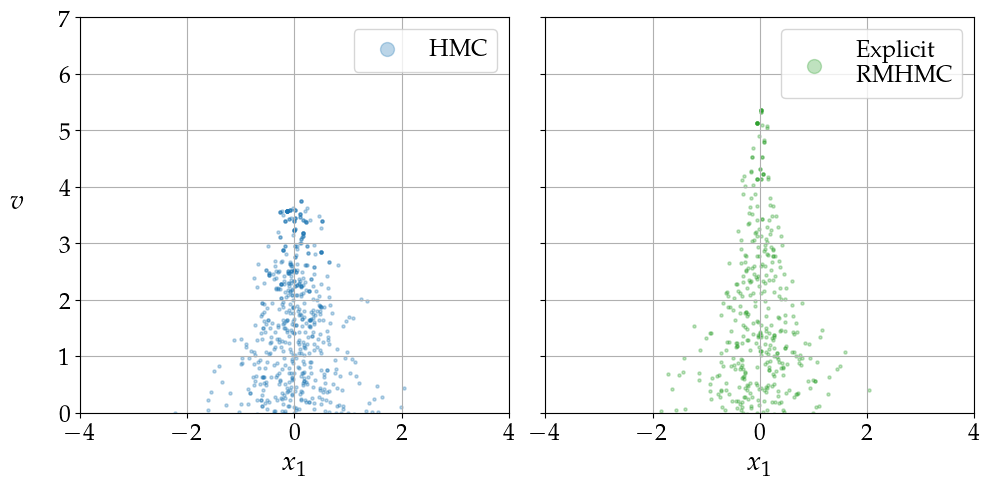

In [2]:
coords_hmc,coords_e_rmhmc = torch.load('etc/funnel_samples.pth')

xlim = [-4,4]
ylim = [0,7]#[-2,9]
text_x = -1.5
text_y = 8
font_size_text = 20
fs = 17
vxx = torch.linspace(xlim[0],xlim[1],300)
p = torch.distributions.Normal(0,3)
v_pdf = torch.exp(p.log_prob(vxx))

fig, axs = plt.subplots(1, 2, figsize=(10,5), sharey=True)
axs[0].scatter(coords_hmc[:,1], coords_hmc[:,0], s=5, alpha=0.3, rasterized=True, \
               color='C0', label='HMC')
l = axs[0].legend(loc=0,fontsize=fs)
l.legendHandles[0]._sizes = [100]
axs[0].grid()
axs[0].set_xlim(xlim)
axs[0].set_ylim(ylim)
axs[0].tick_params(axis='both', labelsize=fs)
axs[0].set_xlabel(r'$x_1$',fontsize=font_size_text)
axs[0].set_ylabel(r'$v$',fontsize=font_size_text,rotation=0,labelpad=30)

axs[1].scatter(coords_e_rmhmc[:,1], coords_e_rmhmc[:,0], s=5, alpha=0.3, rasterized=True, \
               color='C2', label='Explicit\nRMHMC')
l = axs[1].legend(loc=0,fontsize=fs)
l.legendHandles[0]._sizes = [100]
axs[1].grid()
axs[1].set_xlim(xlim)
axs[1].set_ylim(ylim)
axs[1].tick_params(axis='both', labelsize=fs)
axs[1].set_xlabel(r'$x_1$',fontsize=font_size_text)

plt.tight_layout()

## 5. Bridging the Gap between SG-MCMC and Stochastic Optimization

So far, we have seen 
 - gradient descent is a discretized ordinary differential equation
 - adding correct amount of noise to gradient descent iterations leads to MCMC sampling.
 - for any continuous Markov process with a desired stationary distribution, there exists an SDE with a particular form.

Finally, we will see how stochastic gradient MCMC and stochastic optimization methods are related.
To demonstrate basic ideas, we present "[the SANTA paper (Bridging the Gap between SG-MCMC and Stochastic Optimization)](https://arxiv.org/pdf/1512.07962.pdf)".

### 5.1. Simulated Annealing
Our exposition starts with a simple yet effective technique to find the global optima of optimization problems with multiple modes.
Given a small-enough learning rate ensuring convergence, blindly following the gradient would lead to convergence to the nearest mode.
In order to reach the global optimum, an algorithm should (1) first explore the state space, and (2) then converge to the optima.
This is precisely the main idea in simulated annealing.
Originally proposed by [Kirkpatrick et al](http://wexler.free.fr/library/files/kirkpatrick%20(1983)%20optimization%20by%20simulated%20annealing.pdf) in 1983, it aims to smoothly modify the optimization surface so that all regions of the state space can be explored.

To introduce a trivial way of achieving annealling, we note that the following SDE

$$ d\theta_t = - \nabla U(\theta_t)dt + \sqrt{2/\beta} dB(t)$$

has the following invariant distribution

$$ p(\theta) \propto \exp(-\beta U(\theta)). $$

In the following cell, let's see how $\beta$ affects a probability surface.
For a simple illustration, we consider a mixture of Gaussians.

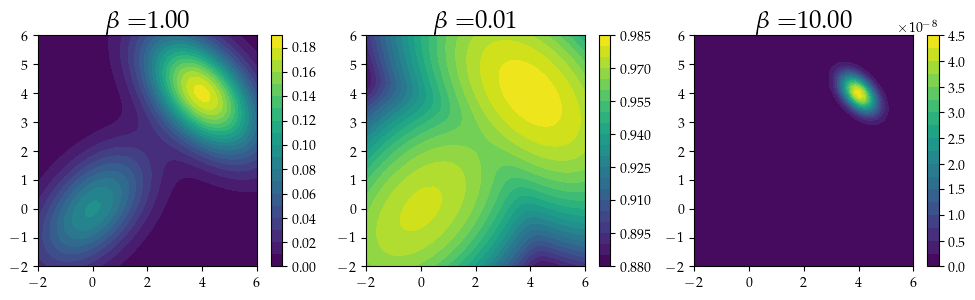

In [20]:
m1 = torch.tensor([0.,0.])
s1 = torch.tensor([[2.,1.],[1.,2.]])
d1 = torch.distributions.MultivariateNormal(m1,s1)

m2 = torch.tensor([4.,4.])
s2 = torch.tensor([[2.,-1.],[-1.,2.]])
d2 = torch.distributions.MultivariateNormal(m2,s2)

def mixture_pdf(X):
    return d1.log_prob(X).exp() + 2*d2.log_prob(X).exp() 

def p(X, beta):
    return (mixture_pdf(X).log()*beta).exp()

original_density = lambda X: p(X, 1.0)
flat_density     = lambda X: p(X, 0.01)
peaky_density    = lambda X: p(X, 10)

plot_mcmc_surface(original_density, flat_density, peaky_density, betas=[1,0.01,10])

As implied by the above picture, increasing $\beta \rightarrow \infty$ leads to a density that concentrates around the global maximum.
This is the very bridge that connects MCMC and optimization.
In the following, we simulate
 - gradient descent, which directly converges to the nearest minimum.
 - Langevin dynamics with $\beta=1$, which oscillates (usually) around the nearest minimum.
 - Langevin dynamics with $\beta$ increasing from $0.01$ to $1000$, which first traverses the state space and then converges.

In [37]:
def mixture_density(X):
    return d1.log_prob(X).exp() + 2*d2.log_prob(X).exp() 

def __U(X):
    return -mixture_density(X).log()

def run_optimization(th0, is_mcmc=False, is_annealed=False):
    thetas, losses, betas = [],[],[]
    th    = torch.nn.Parameter(th0) # initial parameters
    d     = 2
    eta   = 5e-3 # step size
    Niter = 1000
    beta  = 1.0
    beta0 = 0.025
    beta1 = 1000
    p     = np.power(beta1/beta0,1/Niter)
    for i in range(Niter):
        thetas.append(th.detach().numpy().copy())
        U     = __U(th)
        grad  = torch.autograd.grad(U,th)[0]
        th.data = th.data - eta*grad
        if is_mcmc: 
            if is_annealed:
                beta = beta0 * np.power(p,i)
            else:
                beta = 1.0
            noise = torch.randn(1,d) * np.sqrt(2*eta/beta)
            th.data = th.data + noise
        betas.append(beta)
        losses.append(U.item())
    thetas = np.array(thetas).squeeze(1) # Niter,d
    anim = plot_mcmc_animation(mixture_density, thetas, betas, num_frames=25)
    return anim

# anim = run_optimization(torch.tensor([[0.,2.]]), is_mcmc=False)
# anim = run_optimization(torch.tensor([[0.,2.]]), is_mcmc=True, is_annealed=False)
anim = run_optimization(torch.tensor([[0.,2.]]), is_mcmc=True, is_annealed=True)
HTML(anim.to_jshtml())

<Figure size 640x480 with 0 Axes>

### 5.2. Details of SANTA
We conclude this section by listing the details of SANTA.

#### 5.2.1. Thermostats
Based on [this work](https://papers.nips.cc/paper/2014/file/21fe5b8ba755eeaece7a450849876228-Paper.pdf), the authors propose to include "thermostat" variables $\xi$.
These variables  "control the temperature" as it can abruptly increase or decrease due to stochastic drifts or bad estimation of the variance of the noise term $B_t$. 
In a nutshell, following are the update equations:

\begin{align}
    d\theta &= p dt \\
    dp &= \nabla \tilde{U}(\theta) - \xi dt + \mathcal{N}(0, \epsilon_t (2-\epsilon_t B_t)) \\
    d\xi &= \left( \frac{1}{d} p^\top p -1 \right)  dt
\end{align}

Intuitively, if the mean kinetic energy is higher than $1$, then $\xi$ gets bigger and $p$ experiences more friction. 
In the other hand, if the mean kinetic energy is lower, then $\xi$ gets smaller and $p$ experiences less friction.

#### 5.2.2. Riemannian Geometry
Similar to HMC, the authors attempt to include preconditioning matrices to take local geometry into account.
Yet, since computing Fisher information matrices (FIM) is usually expensive, they adopt the preconditioner from RMSprop and Adam, which approximates FIM diagonals.

#### 5.2.3. Symmetric Splitting Scheme
The authors also replace Euler discretization with so-called symmetric splitting scheme (SSS).
In a nutshell, they split an infeasible SDE into several sub-SDEs, each of which is analytically solvable.
This resembles the leap-frog integration used in HMC.

Overall, the method consists in exploration and refinement stages, which first explores the state space and then performs gradient descent.
The refinement step uses both adaptive gradient and adaptive momentum updates.
Below figure shows the behaviour of the optimizer on a toy problem:


<img src="etc/santa.png" width="750"/>

#### Related Paper
This paper describes an [asynchronous stochastic quasi-Newton MCMC for non-Convex optimization method](https://arxiv.org/pdf/1806.02617.pdf).
Here, the authors describe an MCMC method that samples from a target density.
Later, using the temperature trick above, the sampler is turned into an MCMC routine.
Unlike presented Riemannian manifold approaches, they use an approximation to the Hessian to model the local curvature. 


<img src="etc/hamcmc.png" width="750"/>